In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### **1. VERİ YÜKLEME**

# **1.1.	Kütüphanelerin İçe Aktarılması**

Veri işleme için pandas, sayısal işlemler için numpy, görselleştirme için matplotlib ve seaborn kütüphanelerini import ediyoruz

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import seaborn as sns
sns.set()

dosya yolu

In [ ]:
# Ana dizin
drive_path = '/content/drive/MyDrive'

# Dosya adı
file_name = 'train-small.csv'

# Yeni dosya yolu oluşturdum
file_path = os.path.join(drive_path, file_name)

# **1.2.	Veri Setinin Yüklenmesi**

train_df olarak adlandırılan veri çerçevesine CSV dosyasının yüklenmesi ve ilk 5 satırın incelenmesi



In [ ]:
# Read csv file containing training datadata
train_df = pd.read_csv(file_path)
# Print first 5 rows
train_df.head()

,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


*o	Toplam satır ve sütun sayısının ekrana yazdırılması.*

In [ ]:
print(f'Bu verisetinde {train_df.shape[0]} satır ve {train_df.shape[1]} kolon bulunmaktadır.')

Bu verisetinde 1000 satır ve 16 kolon bulunmaktadır.


# **1.3.	Veri Özelliklerinin İncelenmesi**

Sütunlardaki veri türlerinin ve eksik değerlerin incelenmesi:

Özet: Veri seti 16 sütun, 1000 satırdan oluşuyor ve eksik veri bulunmuyor.

In [ ]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

PatientId sütunundaki benzersiz hasta sayısını analiz ederek her bir hastanın birden fazla görüntüsü olup olmadığına bakalım.

In [ ]:
print(f"Toplam veri sayısı {train_df['PatientId'].count()}, toplam hasta sayısı {train_df['PatientId'].value_counts().shape[0]} ")

Toplam veri sayısı 1000, toplam hasta sayısı 928 


### **2. GÖRÜNTÜ YÜKLEME VE GÖRSELLEŞTİRME**

# **2.1.	Rastgele Görüntüler Seçme**

train_df içindeki "Image" sütunundan rastgele 9 görüntü seçelim

In [ ]:
images = train_df['Image'].values
random_images = [np.random.choice(images) for i in range(9)]

Bu görüntüleri yan yana görselleştirerek veri setindeki örnek görüntüleri inceleyelim.

Display Random Images


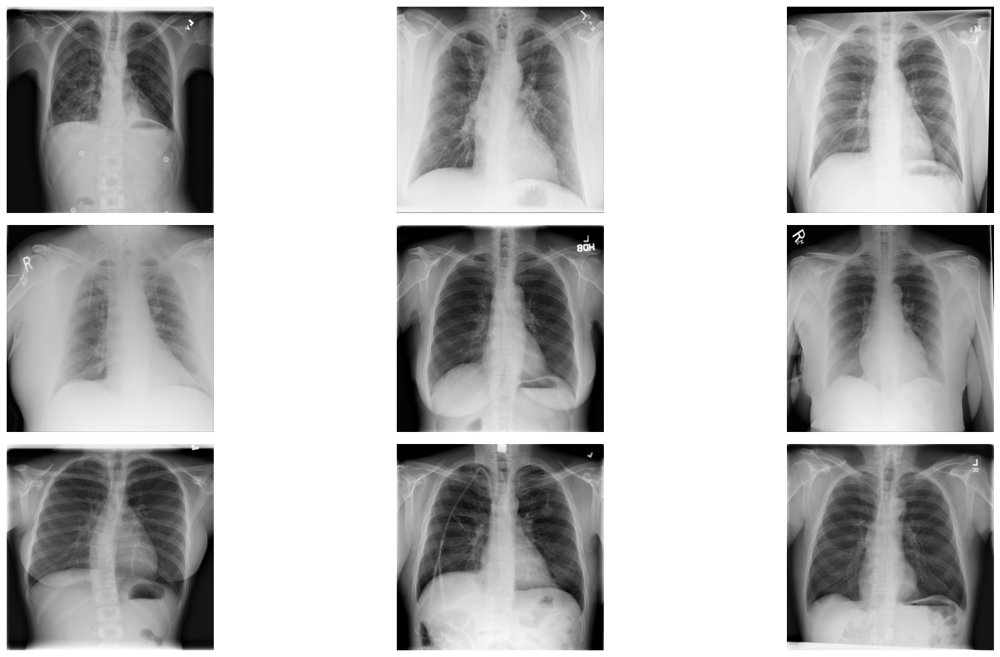

In [ ]:
img_dir = '/content/drive/MyDrive/hatice/images_small'
print('Display Random Images')
plt.figure(figsize=(20,10))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
plt.tight_layout()

# **2.2.	Rastgele Görüntülerin İstatistiksel Özelliklerini Hesaplama**

Seçilen görüntülerin her biri için maksimum, minimum, ortalama ve standart sapma değerlerini hesaplayalım


Rastgele seçilen 9 adet görüntünün analizi:

--- Analiz edilen görüntü 1: 00013111_093.png ---


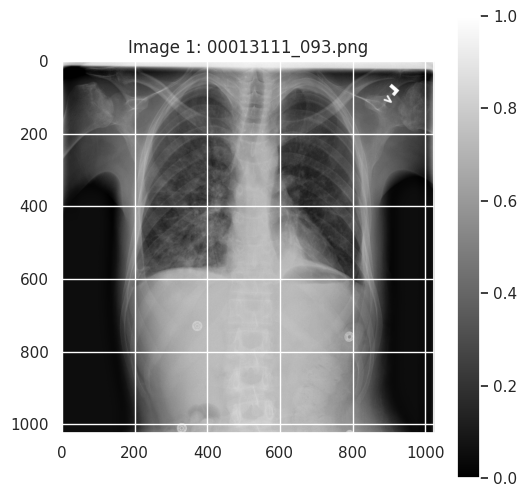

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 1.0000 ve minimumu 0.0000
Piksellerin ortalama değeri 0.3993 ve standart sapması 0.2527


--- Analiz edilen görüntü 2: 00015056_005.png ---


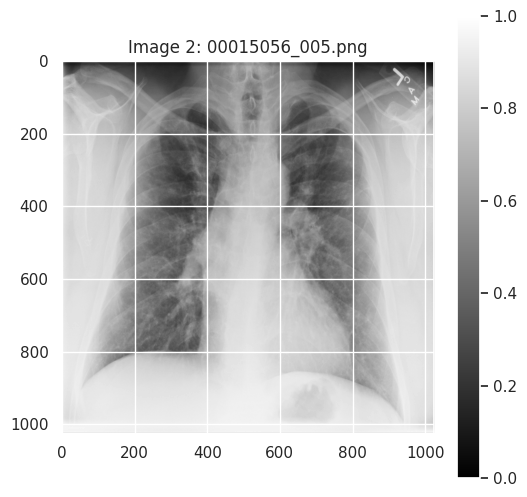

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 1.0000 ve minimumu 0.0000
Piksellerin ortalama değeri 0.6709 ve standart sapması 0.2112


--- Analiz edilen görüntü 3: 00008515_006.png ---


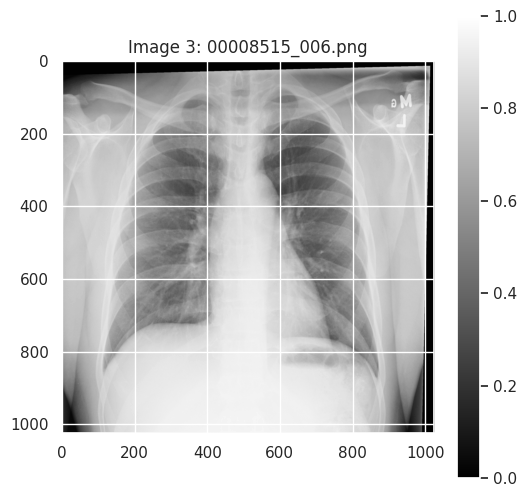

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 1.0000 ve minimumu 0.0000
Piksellerin ortalama değeri 0.6686 ve standart sapması 0.2317


--- Analiz edilen görüntü 4: 00013089_003.png ---


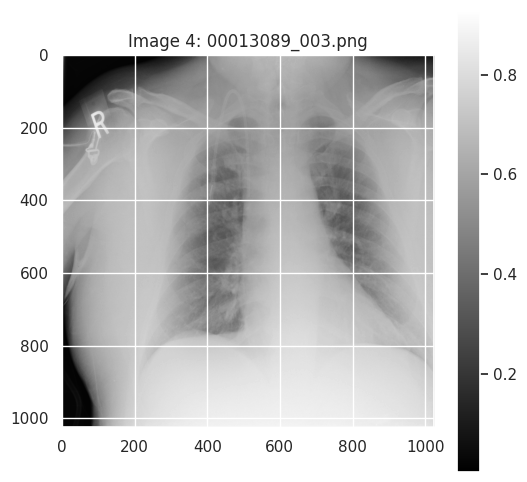

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 0.9294 ve minimumu 0.0039
Piksellerin ortalama değeri 0.6053 ve standart sapması 0.1775


--- Analiz edilen görüntü 5: 00014603_001.png ---


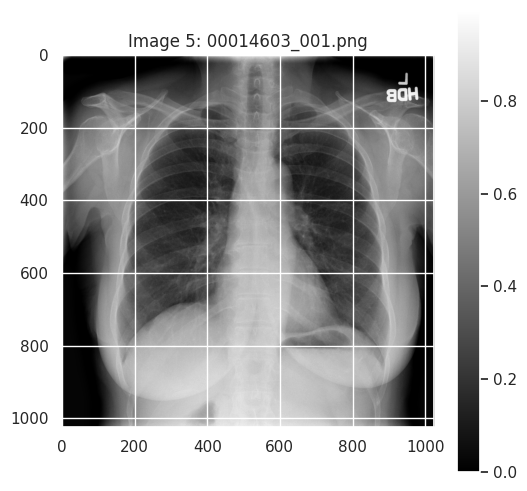

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 0.9961 ve minimumu 0.0000
Piksellerin ortalama değeri 0.4306 ve standart sapması 0.2491


--- Analiz edilen görüntü 6: 00009323_003.png ---


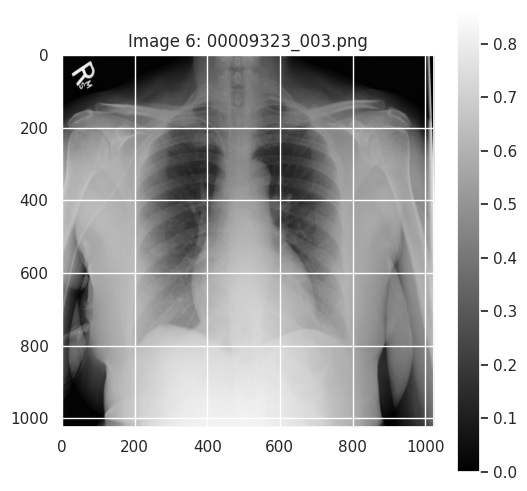

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 0.8627 ve minimumu 0.0000
Piksellerin ortalama değeri 0.4491 ve standart sapması 0.2125


--- Analiz edilen görüntü 7: 00020769_000.png ---


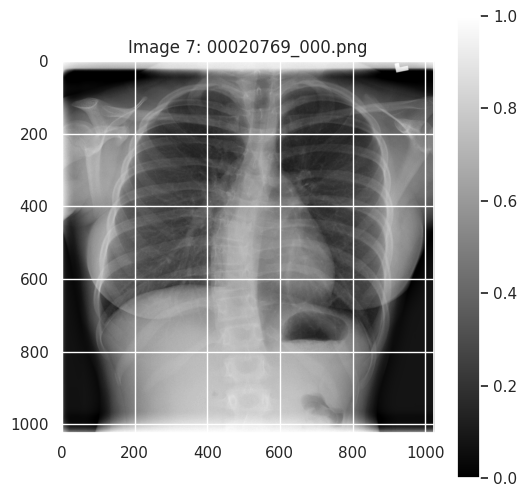

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 1.0000 ve minimumu 0.0000
Piksellerin ortalama değeri 0.4340 ve standart sapması 0.2352


--- Analiz edilen görüntü 8: 00023079_002.png ---


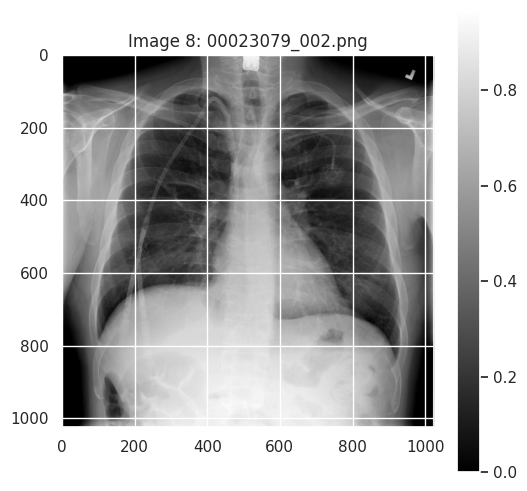

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 0.9686 ve minimumu 0.0000
Piksellerin ortalama değeri 0.4659 ve standart sapması 0.2566


--- Analiz edilen görüntü 9: 00021623_000.png ---


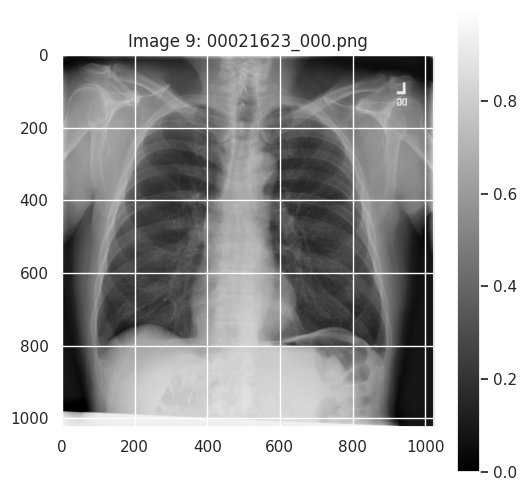

Görüntünün boyutları 1024 piksel genişlik ve 1024 piksel yükseklik, tek bir renk kanalı.
Piksel değerlerinin maksimumu 0.9961 ve minimumu 0.0000
Piksellerin ortalama değeri 0.4569 ve standart sapması 0.2286




In [ ]:
# Rastgele seçilmiş 9 görüntü için analiz
img_dir = '/content/drive/MyDrive/hatice/images_small'

print("Rastgele seçilen 9 adet görüntünün analizi:\n")
for i, sample_img in enumerate(random_images):
    print(f"--- Analiz edilen görüntü {i+1}: {sample_img} ---")

    # Görüntüyü okuma
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    # Görüntüyü görselleştirme
    plt.figure(figsize=(6, 6))
    plt.imshow(raw_image, cmap='gray')
    plt.colorbar()
    plt.title(f'Image {i+1}: {sample_img}')
    plt.show()

    # Görüntü özelliklerini yazdırma
    print(f"Görüntünün boyutları {raw_image.shape[0]} piksel genişlik ve {raw_image.shape[1]} piksel yükseklik, tek bir renk kanalı.")
    print(f"Piksel değerlerinin maksimumu {raw_image.max():.4f} ve minimumu {raw_image.min():.4f}")
    print(f"Piksellerin ortalama değeri {raw_image.mean():.4f} ve standart sapması {raw_image.std():.4f}")
    print("\n")


# **2.3.	Histogram Çizimi**

Seçilen 9 görüntünün her biri için piksel yoğunluk dağılımını gösteren histogramları oluşturalım.

Seçilen 9 görüntünün piksel yoğunluk dağılımını gösteren histogramlar :



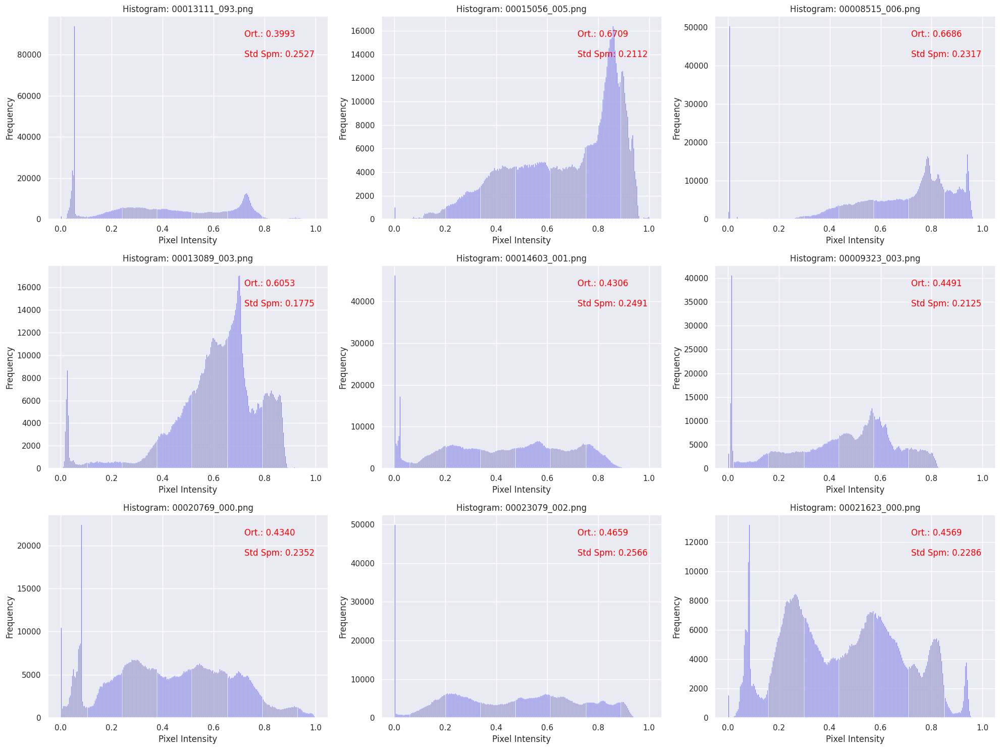

In [ ]:
print("Seçilen 9 görüntünün piksel yoğunluk dağılımını gösteren histogramlar :\n")
plt.figure(figsize=(20, 15))

for i, sample_img in enumerate(random_images):
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    pixel_mean = raw_image.mean()
    pixel_std = raw_image.std()

    plt.subplot(3, 3, i + 1)
    plt.hist(raw_image.ravel(), bins=256, range=(0, 1), color='blue', alpha=0.7)
    plt.title(f'Histogram: {sample_img}')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.grid(True)

    plt.text(0.7, 0.9, f'Ort.: {pixel_mean:.4f}', transform=plt.gca().transAxes, fontsize=12, color='red')
    plt.text(0.7, 0.8, f'Std Spm: {pixel_std:.4f}', transform=plt.gca().transAxes, fontsize=12, color='red')

plt.tight_layout()
plt.show()

### **3. GÖRÜNTÜ İŞLEME VE İYİLEŞTİRME**

# **3.1/2/3.	Kontrast Germe,Histogram Eşitleme,Gamma Düzeltme**

Minimum ve maksimum piksel değerlerini kullanarak kontrast germe işlemi yapalım.

Kontrast germe işlemi sonrası histogram eşitleme uygulayarak kontrastı artıralım.

Gamma düzeltme yöntemi ile görüntünün parlaklığını ayarlayalım.

In [ ]:
from skimage import exposure

<Figure size 2000x1500 with 0 Axes>

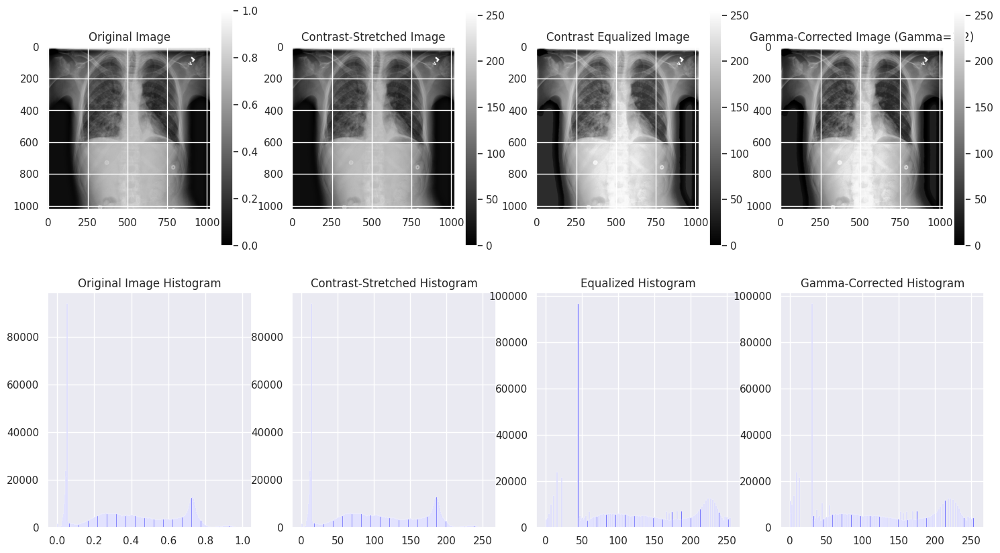

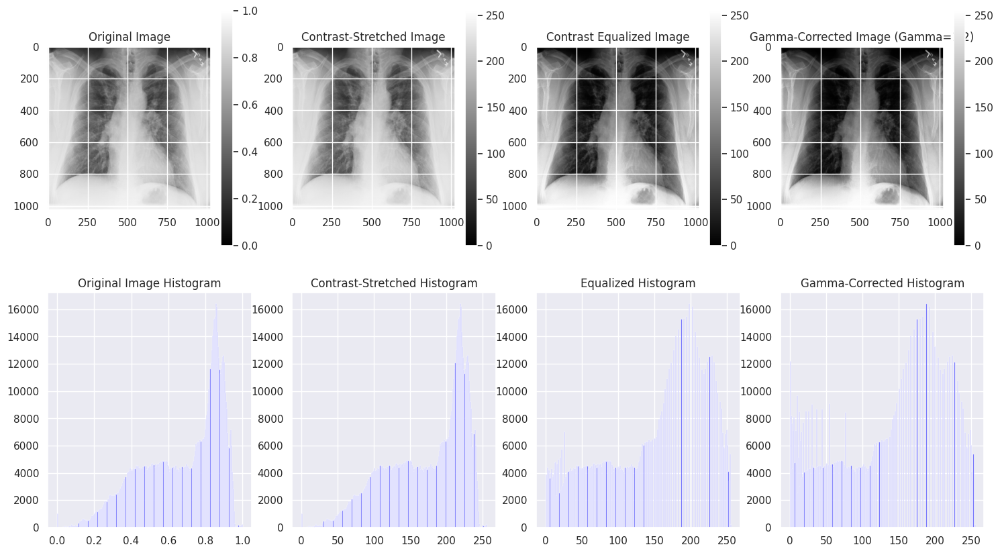

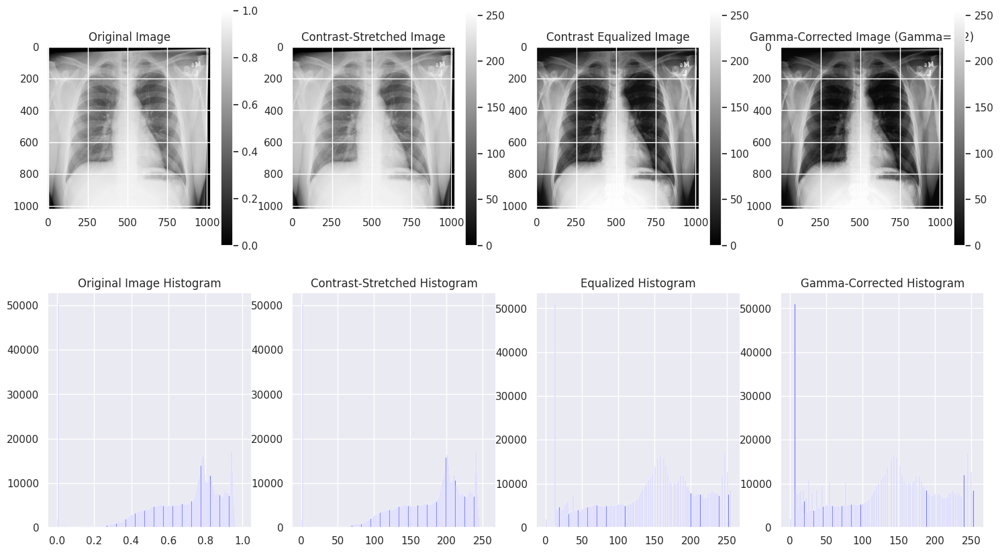

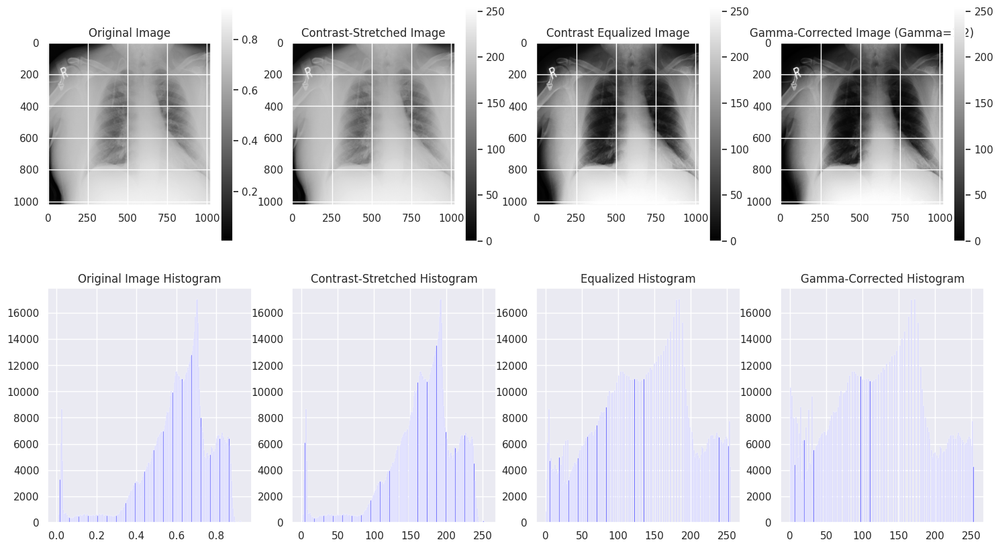

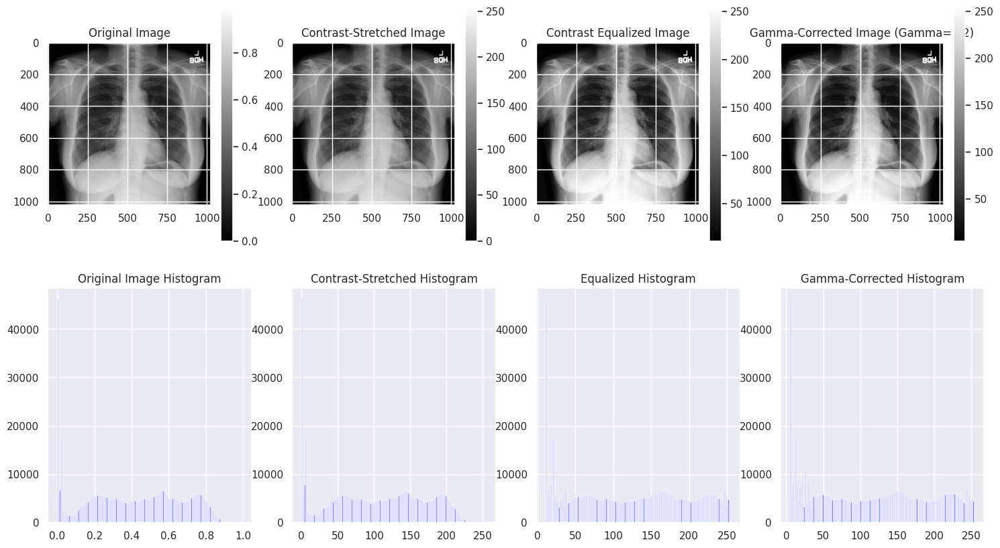

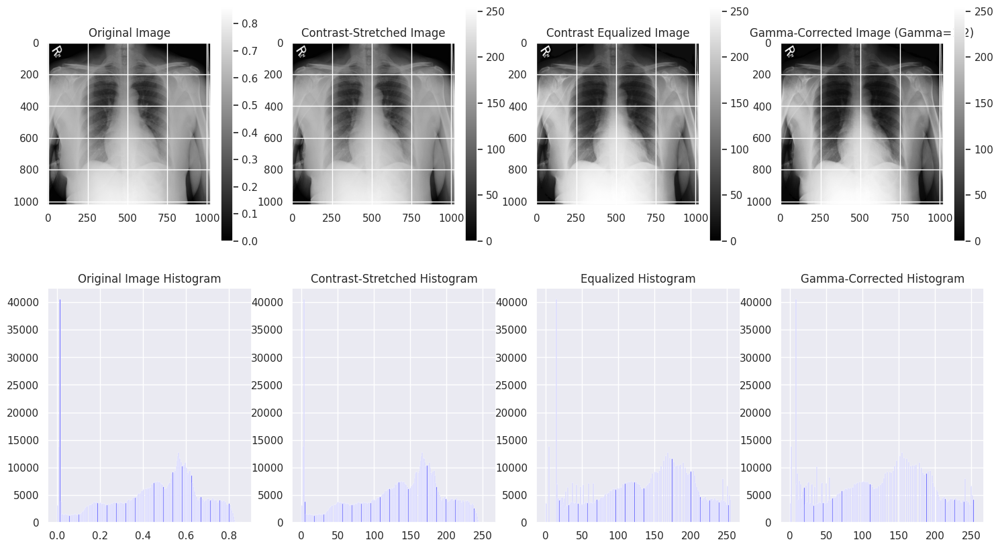

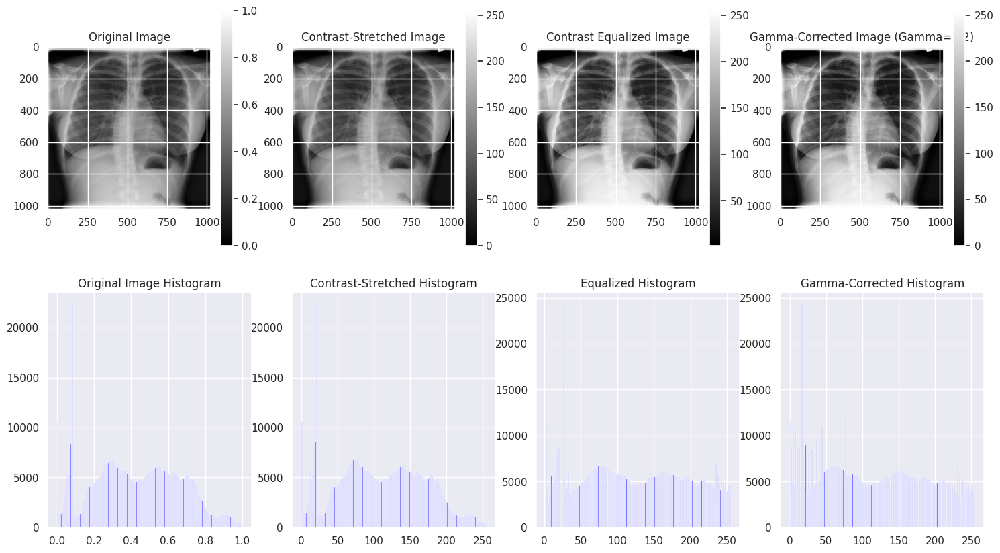

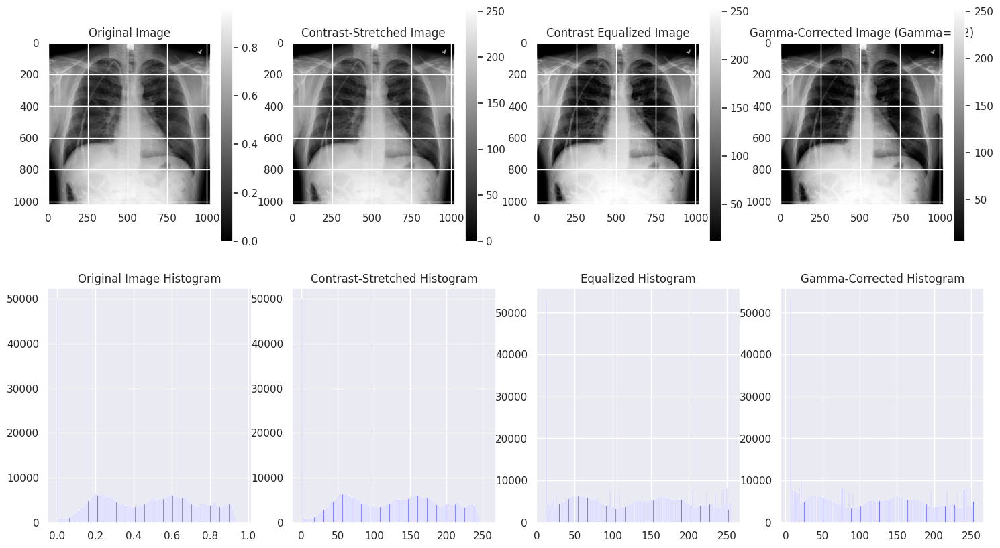

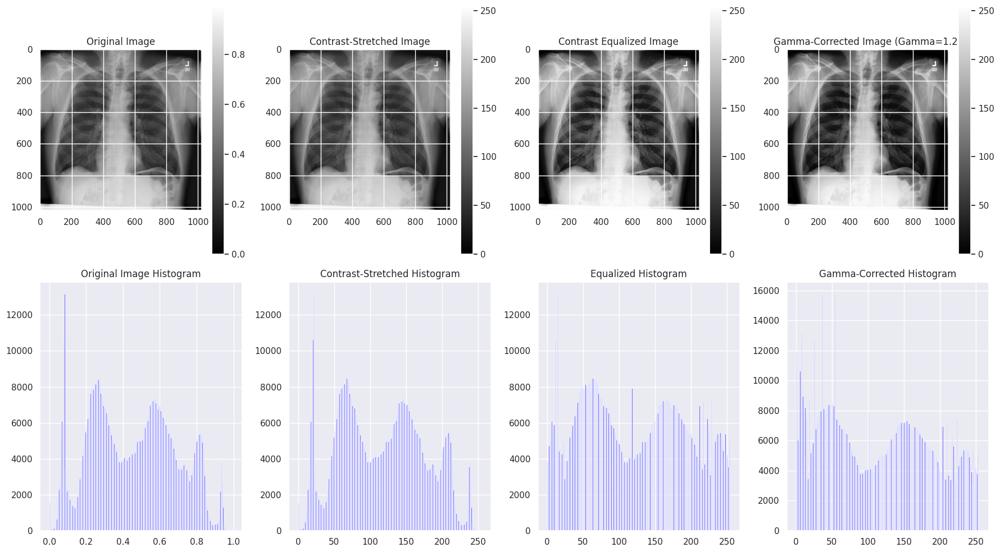

In [ ]:
plt.figure(figsize=(20, 15))

# Gamma düzeltmesi yapılmış görüntüleri saklayacağımız bir liste
gamma_corrected_images = []

for i, sample_img in enumerate(random_images):
    # Görüntüyü okuma
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    # Minimum ve maksimum piksel değerlerini hesaplama
    min_val, max_val = raw_image.min(), raw_image.max()

    # Kontrast germe işlemi
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Kontrast germe sonrası Histogram eşitleme işlemi
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Returns values in [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Gamma düzeltme
    gamma = 1.2
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Gamma düzeltilmiş görüntüyü listeye ekle
    gamma_corrected_images.append(gamma_corrected)

    # Plot original image and histogram
    plt.figure(figsize=(18, 10))
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='blue', alpha=0.7)
    plt.title("Original Image Histogram")

    # Plot contrast-stretched image and histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='blue', alpha=0.7)
    plt.title("Contrast-Stretched Histogram")

    # Plot contrast-equalized image and histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='blue', alpha=0.7)
    plt.title("Equalized Histogram")

    # Plot gamma-corrected image and histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='blue', alpha=0.7)
    plt.title("Gamma-Corrected Histogram")

plt.tight_layout()
plt.show()

### **4. GÜRÜLTÜ AZALTMA**

# **4.1.	Median ve Gaussian Blur Uygulama**

Gamma düzeltilmiş görüntüye median ve gaussian blur uygulayalım ve sonuçları karşılaştıralım.

In [ ]:
import cv2

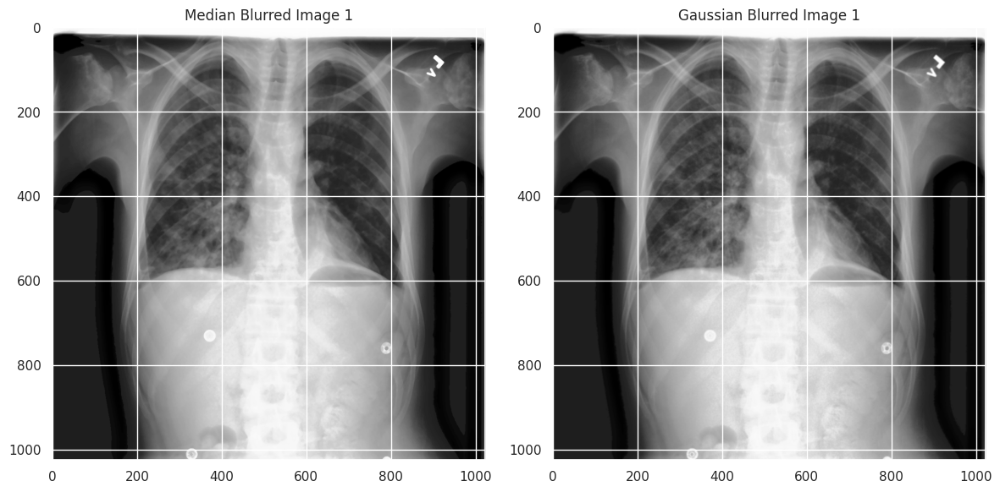

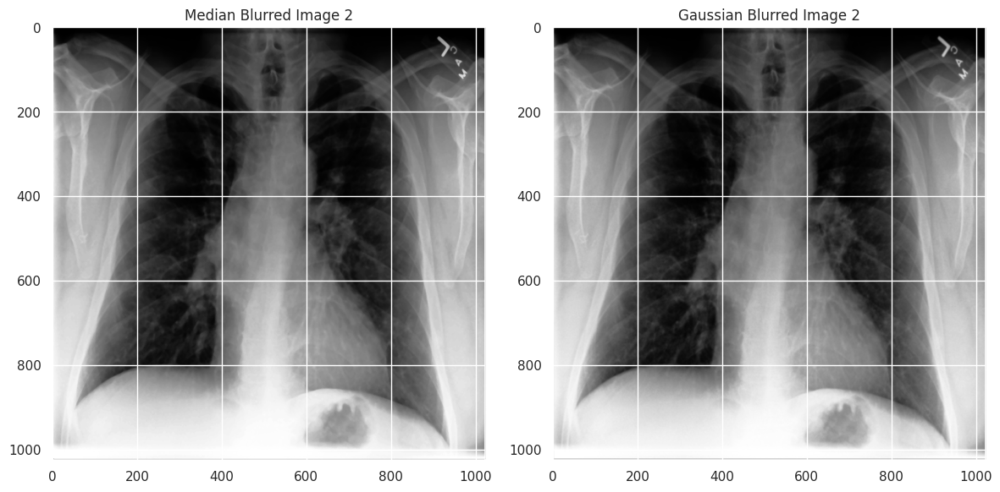

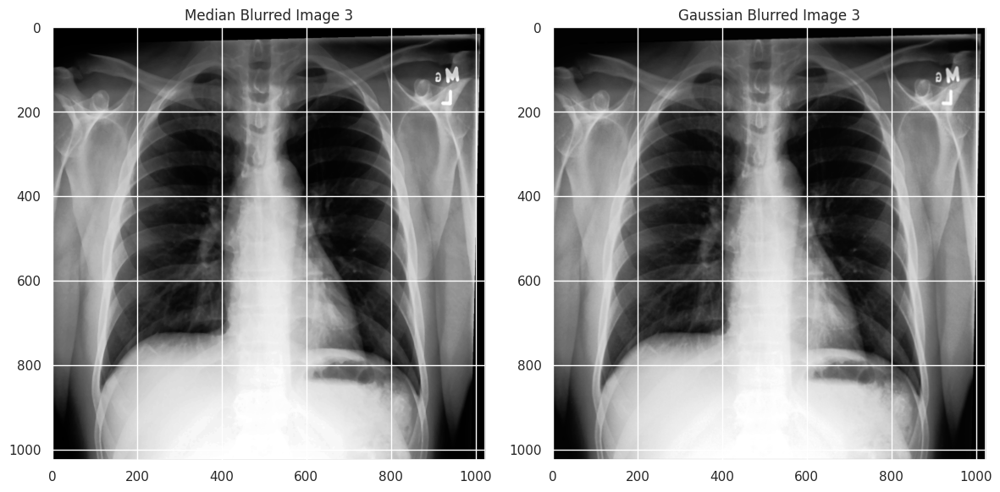

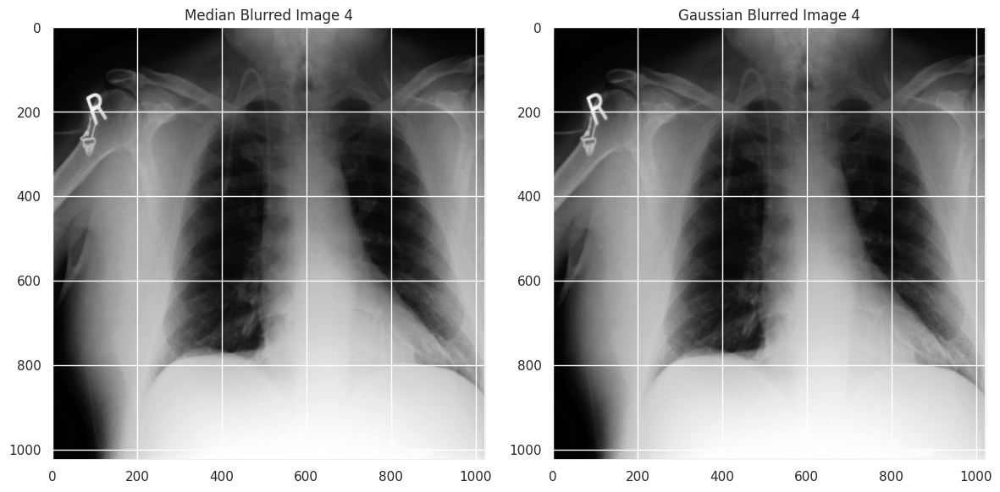

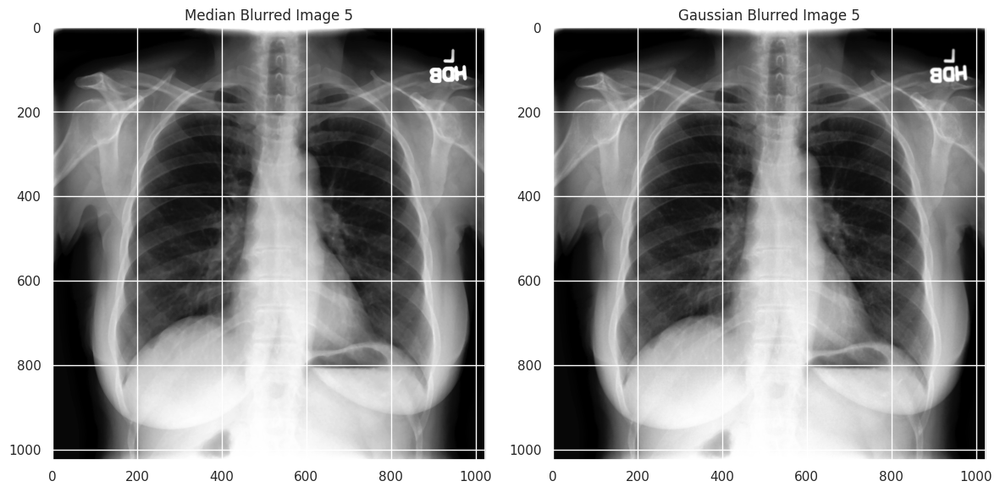

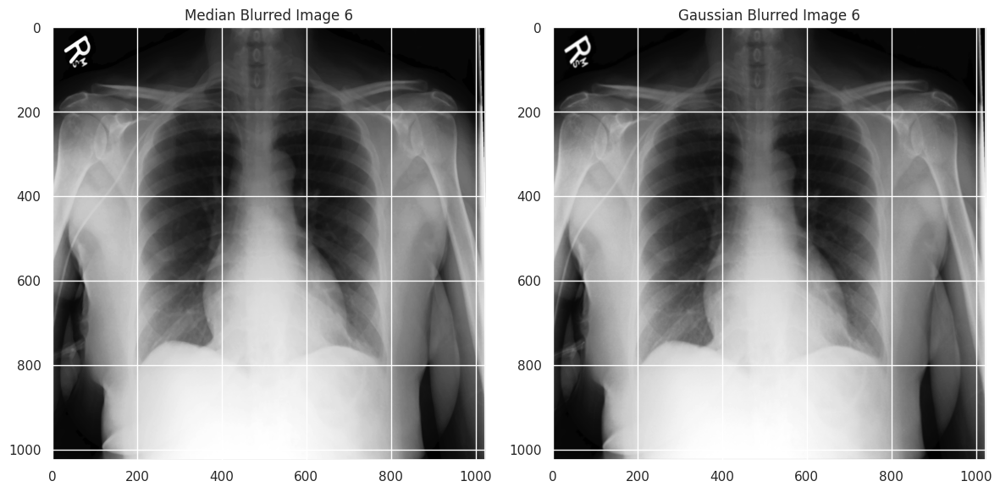

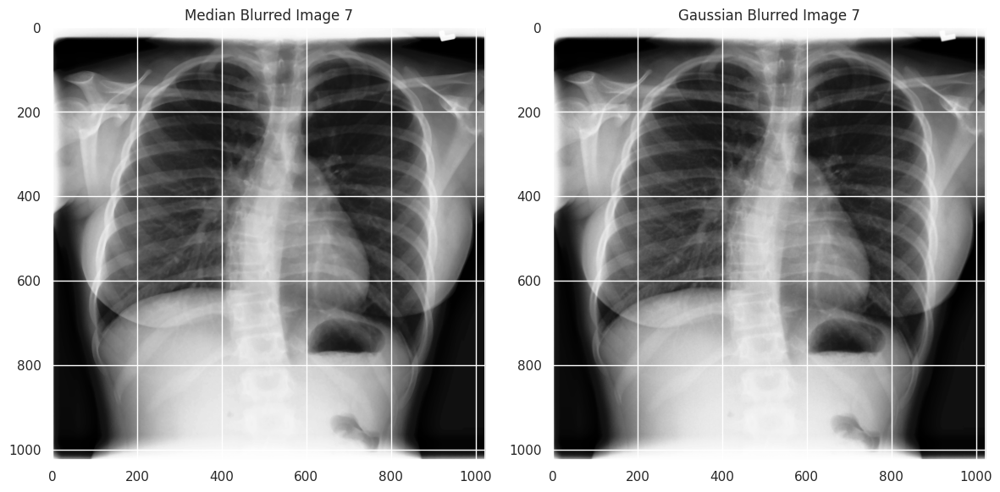

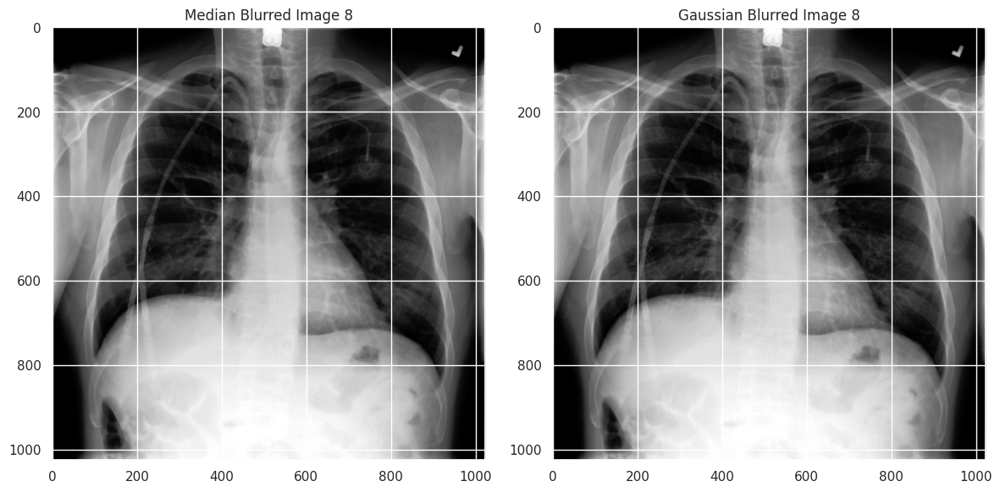

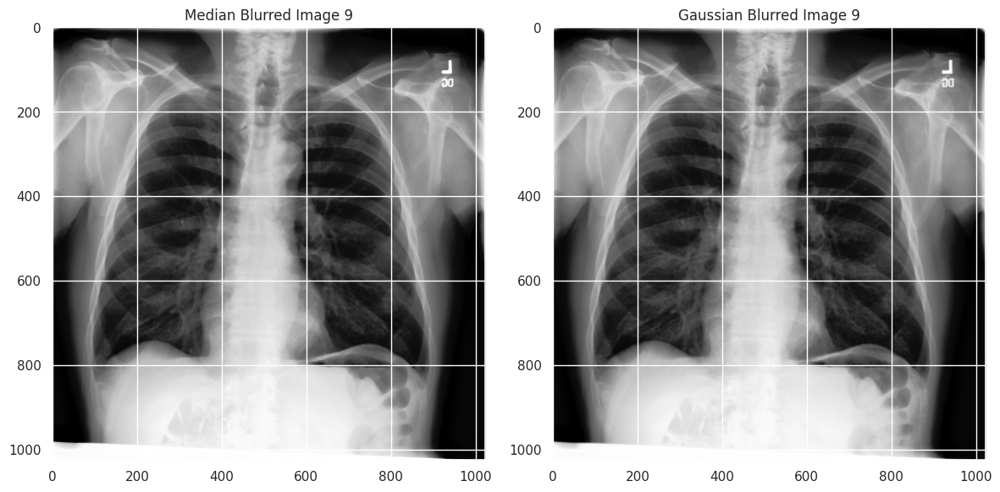

In [ ]:
# Median Blur uygulama yapılmış görüntüleri saklayacağımız bir liste
median_filtered_images = []

for i, gamma_corrected in enumerate(gamma_corrected_images):

    # Median Blur uygulama
    median_filtered = cv2.medianBlur(gamma_corrected, 5)

    # Median Blur uygulanmış görüntüyü listeye ekle
    median_filtered_images.append(median_filtered)

    # Gaussian Blur uygulama
    gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

    # Görselleştirme
    plt.figure(figsize=(12, 6))

    # Median Blur görüntüsü
    plt.subplot(1, 2, 1)
    plt.imshow(median_filtered, cmap='gray')
    plt.title(f"Median Blurred Image {i+1}")

    # Gaussian Blur görüntüsü
    plt.subplot(1, 2, 2)
    plt.imshow(gaussian_filtered, cmap='gray')
    plt.title(f"Gaussian Blurred Image {i+1}")

    plt.tight_layout()
    plt.show()

### **5. DÖNDÜRME ve AYNA ÇEVİRME (Flipping)**

# **5.1. Rastgele Açılarla Döndürme**

Görüntüyü 0 ile 10 derece arasında rastgele bir açıda döndürelim.

In [ ]:
# rotated edilmiş görüntüleri saklayacağımız bir liste
rotated_images=[]

for i, median_filtered in enumerate(median_filtered_images):

  center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
  rotation_matrix = cv2.getRotationMatrix2D(center, angle=10, scale=1.0)
  rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

  # rotated uygulanmış görüntüyü listeye ekle
  rotated_images.append(rotated_image)

# **5.2. Ayna Çevirme**

Görüntüyü yatay olarak çevirelim.

In [ ]:
# flipped edilmiş görüntüleri saklayacağımız bir liste
flipped_horizontal_images=[]

for i, median_filtered in enumerate(median_filtered_images):

  flipped_horizontal = cv2.flip(median_filtered, 1)

  # flip uygulanmış görüntüyü listeye ekle
  flipped_horizontal_images.append(flipped_horizontal)

Sonuçları görselleştirelim.

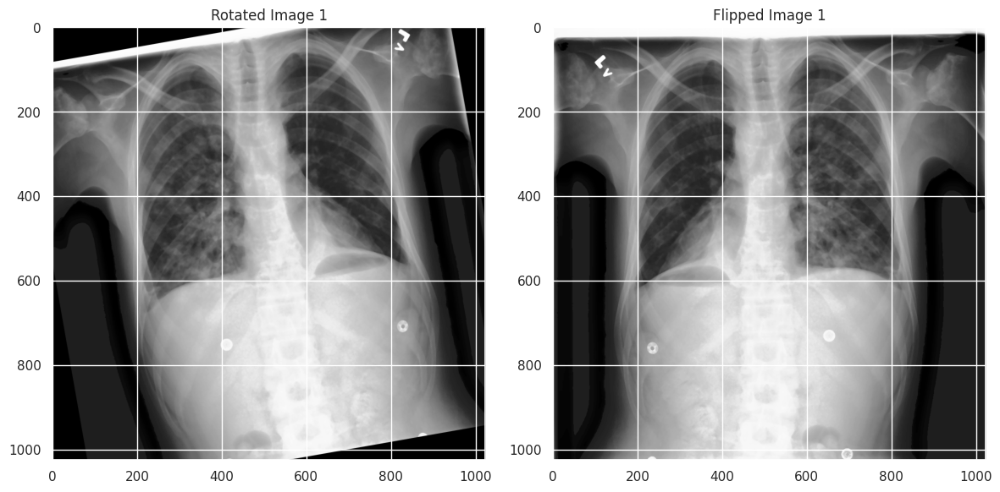

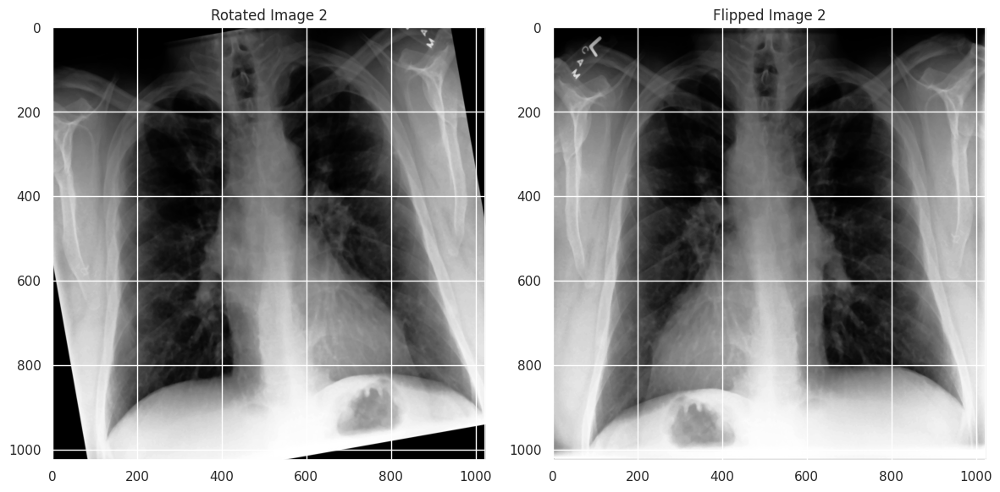

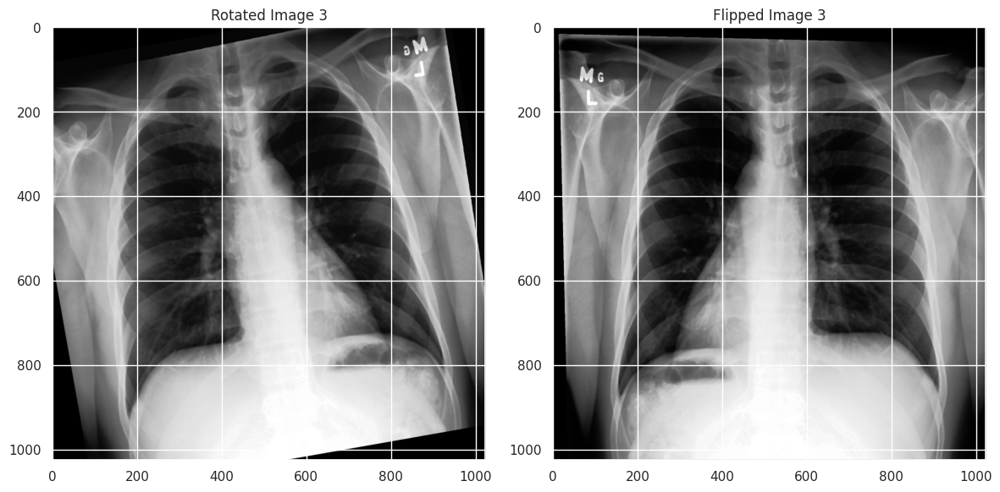

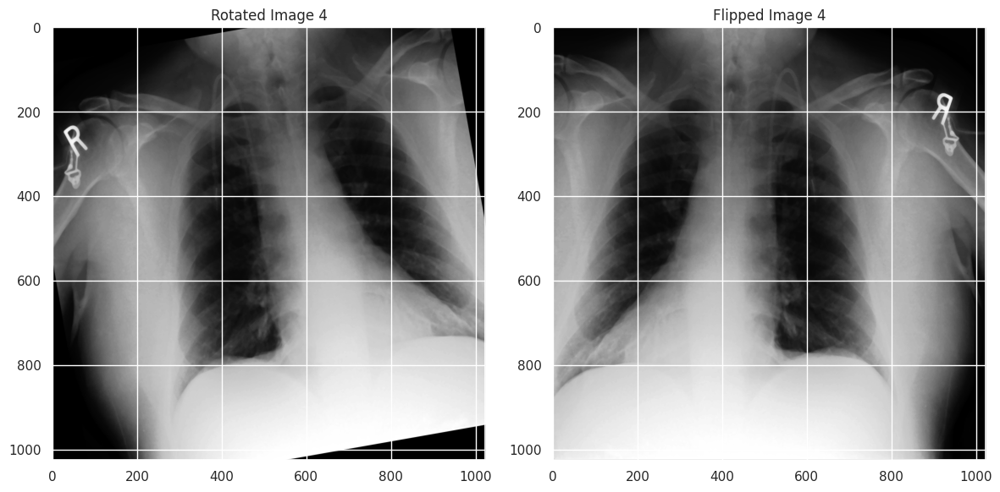

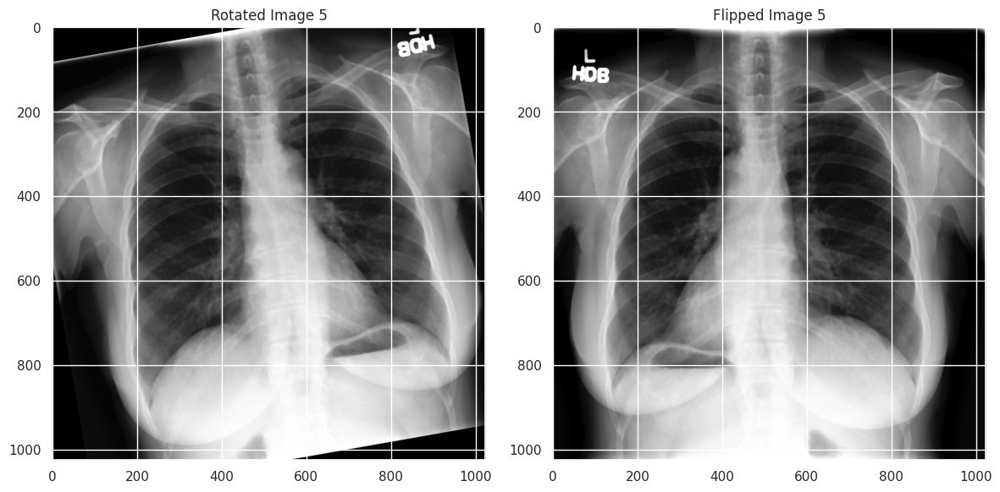

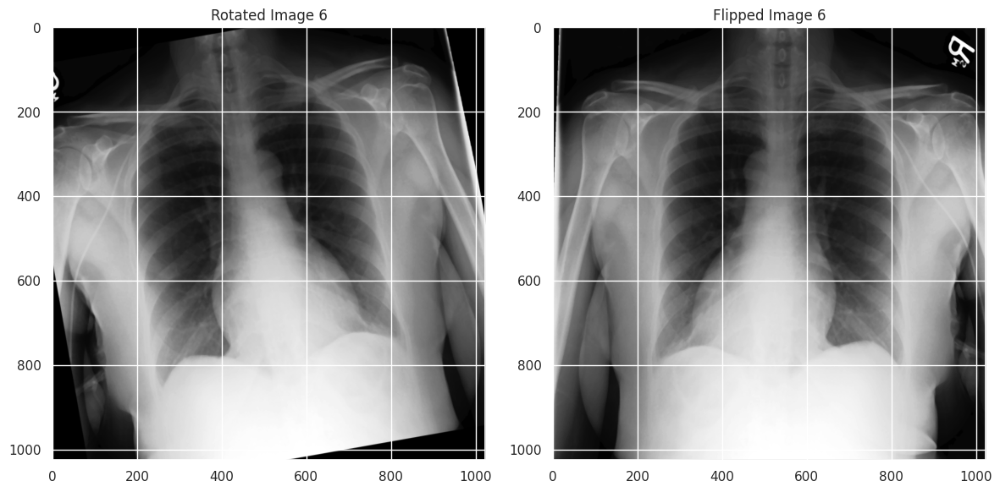

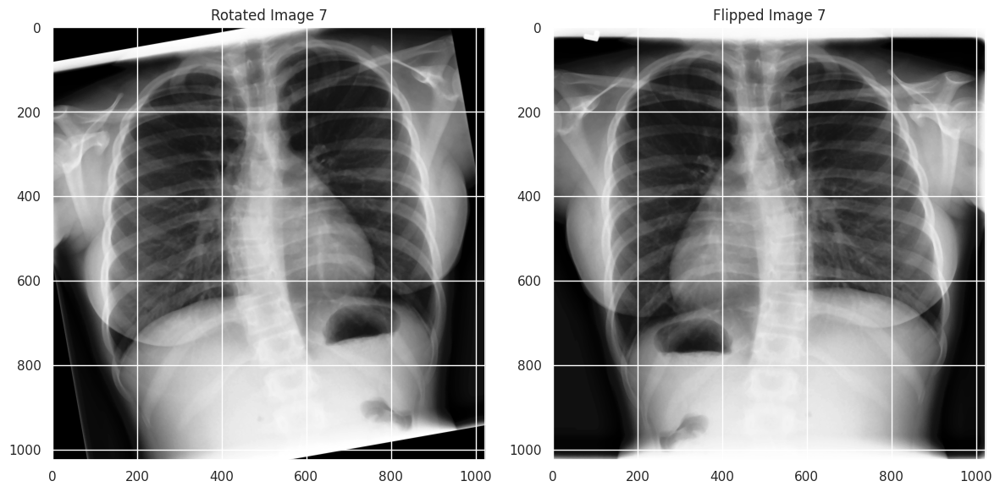

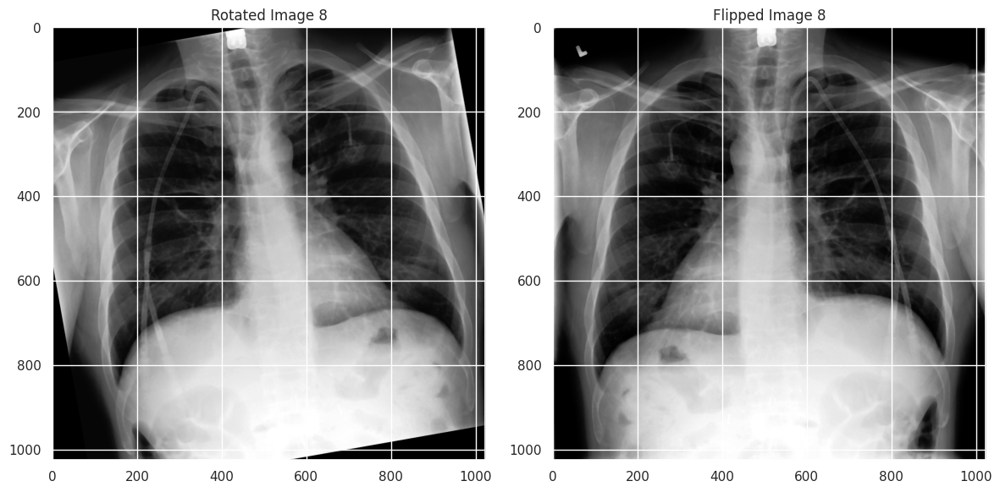

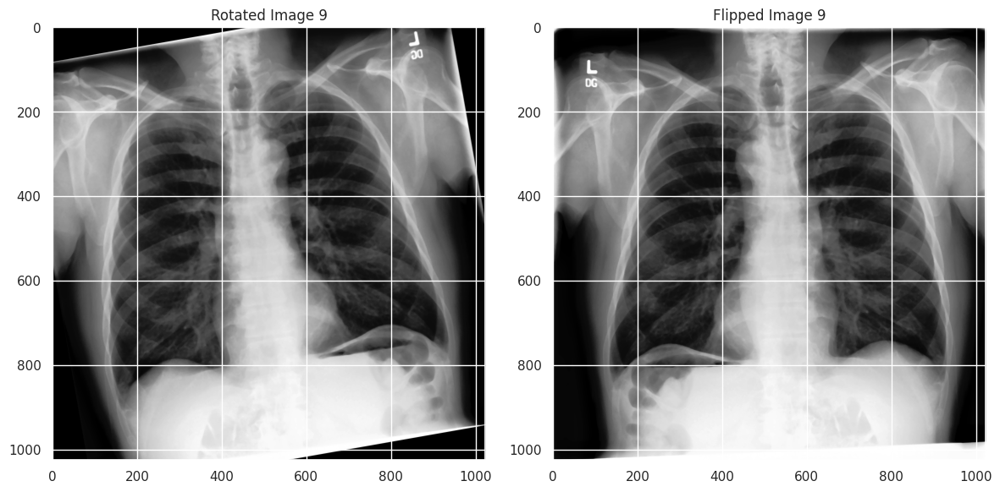

In [ ]:
for i in range(9):  # 9 görüntüyü işle
    rotated_image = rotated_images[i]
    flipped_image = flipped_horizontal_images[i]

    # Görselleştirme
    plt.figure(figsize=(12, 6))

    # Rotated görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(rotated_image, cmap='gray')
    plt.title(f"Rotated Image {i+1}")

    # Flipped görüntü
    plt.subplot(1, 2, 2)
    plt.imshow(flipped_image, cmap='gray')
    plt.title(f"Flipped Image {i+1}")

    plt.tight_layout()
    plt.show()

6. FREKANS ALANINDA FİLTRELEME

# **6.1. Fourier Dönüşümü ve Filtreleme**

Fourier dönüşümü ile görüntüyü frekans alanına çevirelim, düşük frekansları geçiren bir maske uygulayalım, ardından ters Fourier dönüşümü ile frekans alanında filtreleme yapalım.

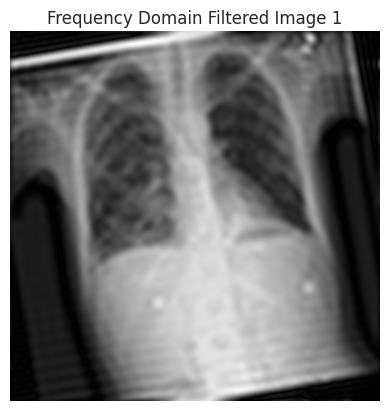

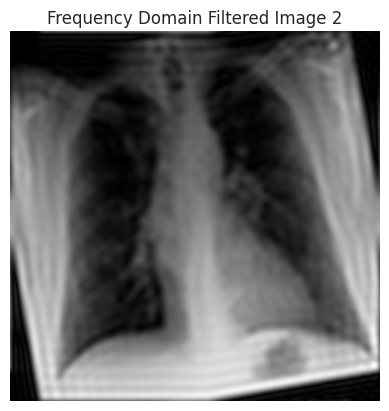

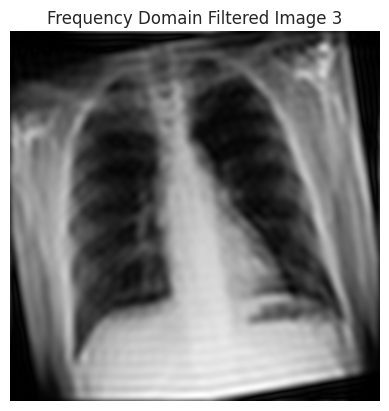

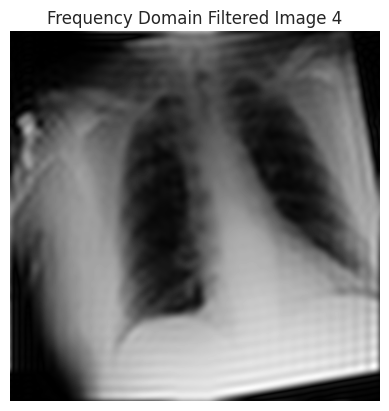

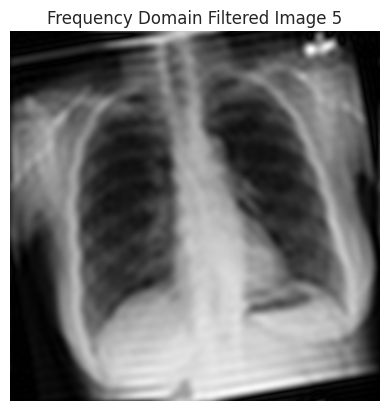

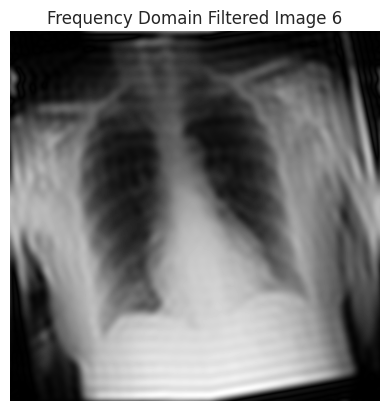

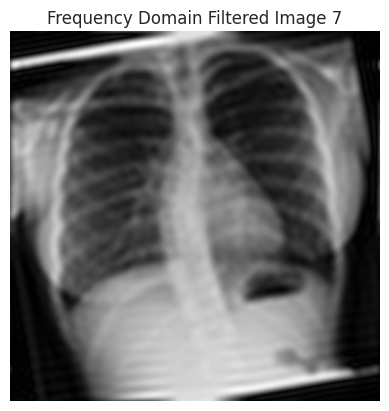

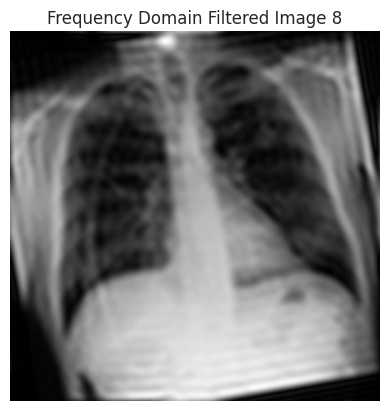

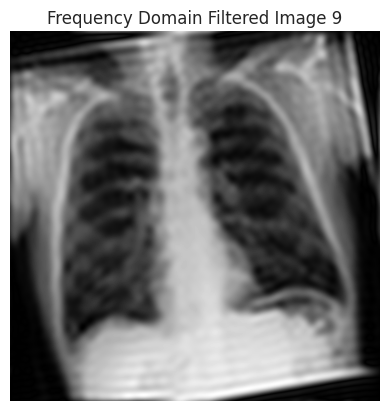

In [ ]:
for i, rotated_image in enumerate(rotated_images):

  # Fourier Dönüşümünü Uygula ve düşük frekansları merkeze kaydır
  dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
  dft_shifted = np.fft.fftshift(dft)

  # Filtreleme için bir maske oluştur
  rows, cols = rotated_image.shape
  crow, ccol = rows // 2 , cols // 2
  mask = np.zeros((rows, cols, 2), np.uint8)
  mask[crow-30:crow+30, ccol-30:ccol+30] = 1  # Center low frequencies pass

  # Maskeyi uygula ve ters DFT yap
  fshift = dft_shifted * mask
  f_ishift = np.fft.ifftshift(fshift)
  filtered_image = cv2.idft(f_ishift)
  filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

  # Görüntüleri normalize et ve filtrelenmiş görüntüleri göster
  filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
  plt.imshow(filtered_image, cmap='gray')
  plt.title(f"Frequency Domain Filtered Image {i+1}")
  plt.axis("off")
  plt.show()

### **7. KESKİNLEŞTİRME VE ENTERPOLASYON**

# **7.1. Keskinleştirme**

Unsharp masking tekniği kullanarak görüntüyü keskinleştirelim.

In [ ]:
from scipy.ndimage import zoom

In [ ]:
# Unsharp Masking görüntüleri saklayacağımız bir liste
unsharp_masking_images = []

sharpening_kernel = np.array([[-1, -1, -1],
                              [-1,  9, -1],
                              [-1, -1, -1]])

for i, gamma_corrected in enumerate(gamma_corrected_images):

  sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

  # Unsharp Masking uygulanmış görüntüyü listeye ekle
  unsharp_masking_images.append(sharpened_image)

# **7.2. Bicubic Enterpolasyon**

Keskinleştirilmiş görüntüyü iki kat büyüterek enterpolasyon uygulayalım.

In [ ]:
# Bicubic Enterpolasyon görüntüleri saklayacağımız bir liste
bicubic_images = []

scale_factor = 2

for i, sharpened_image in enumerate(unsharp_masking_images):

  resized_image = zoom(sharpened_image, scale_factor, order=3)

  # Bicubic Enterpolasyon uygulanmış görüntüyü listeye ekle
  bicubic_images.append(resized_image)

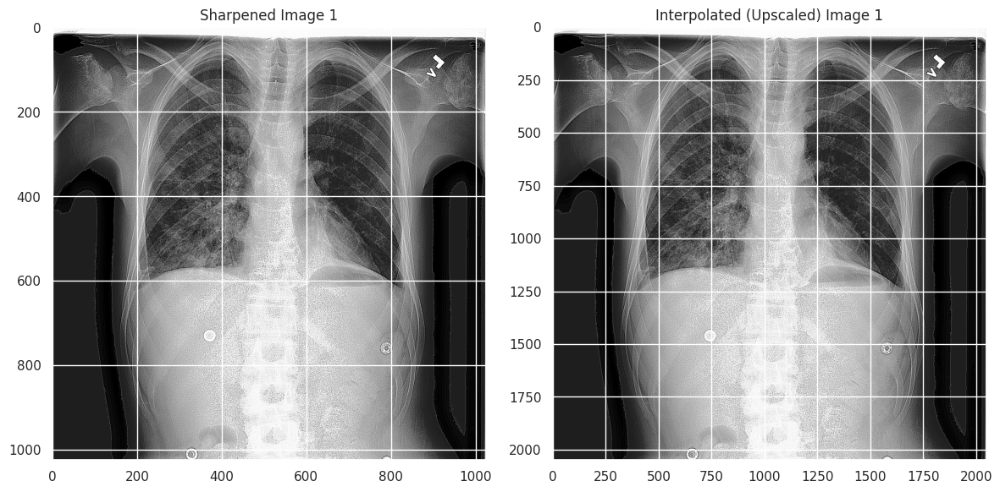

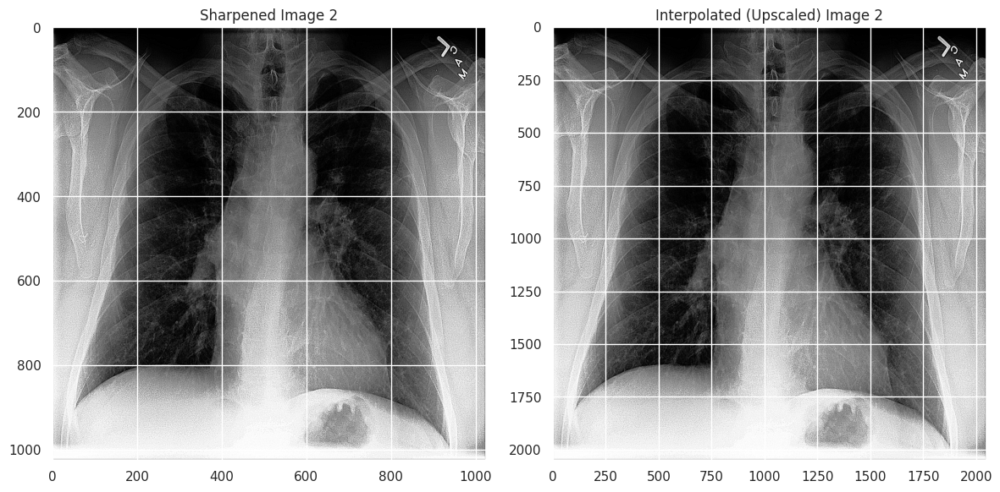

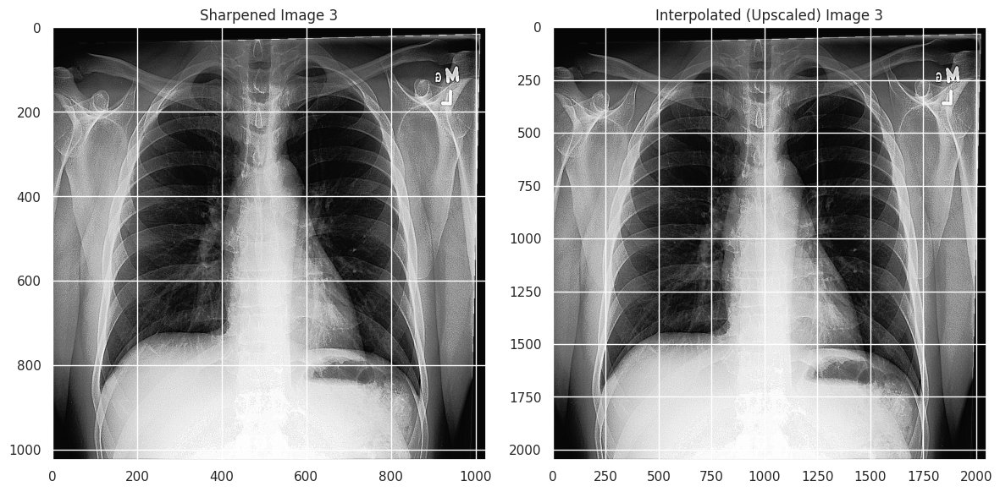

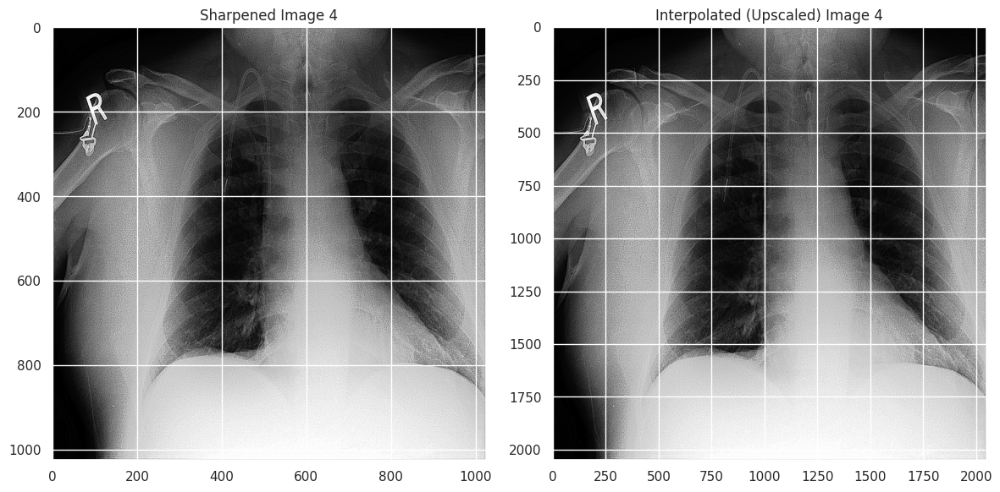

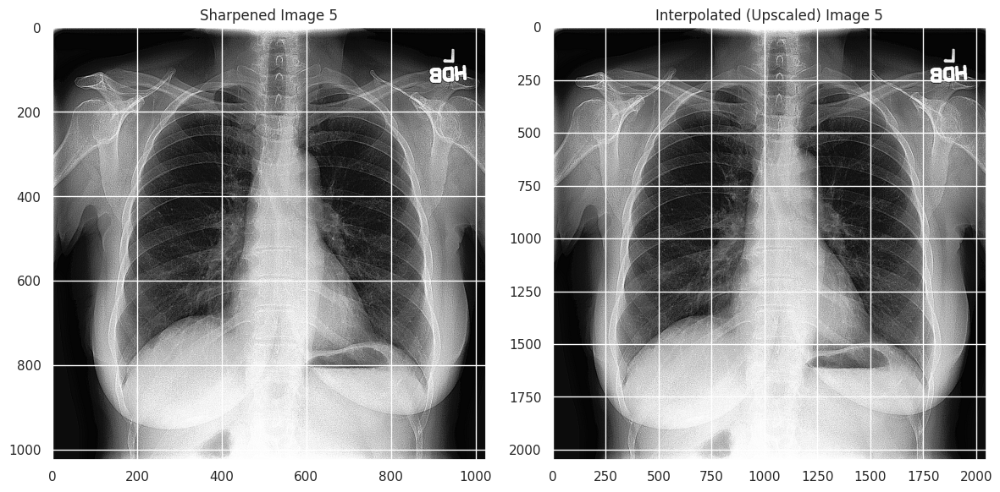

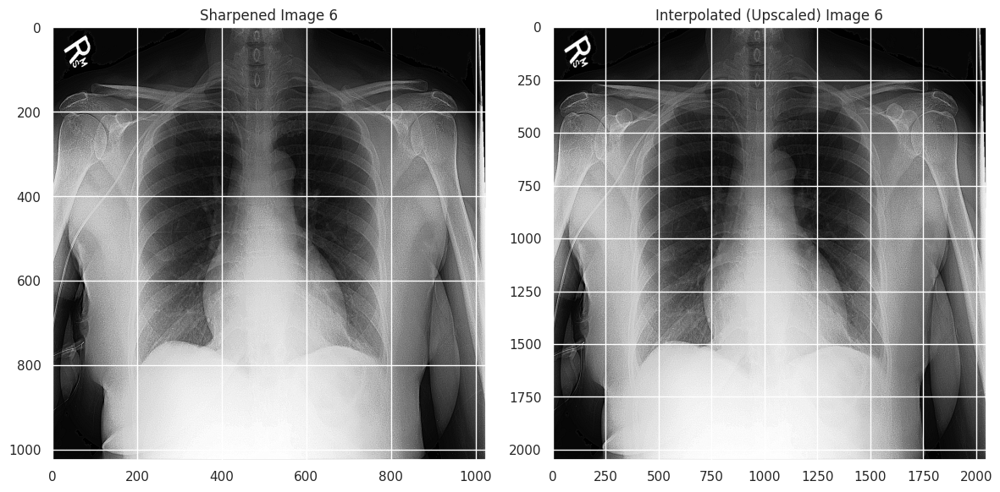

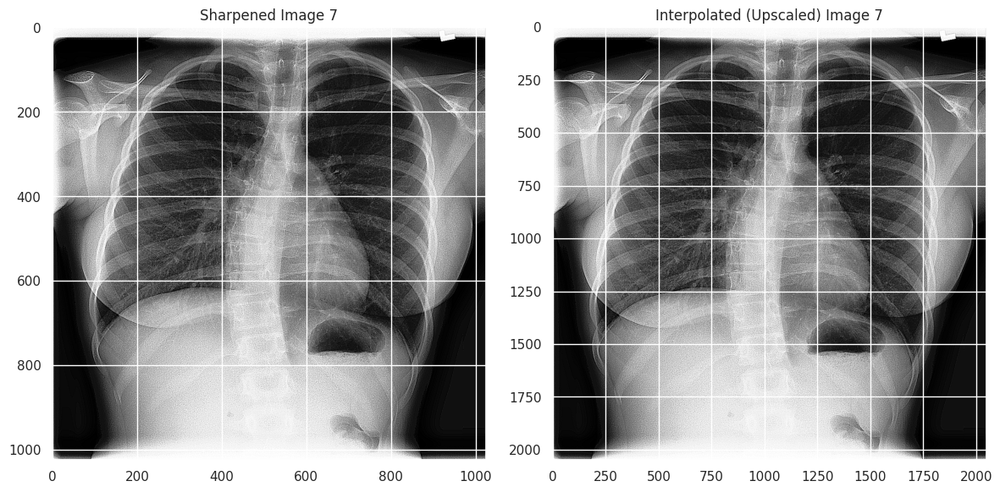

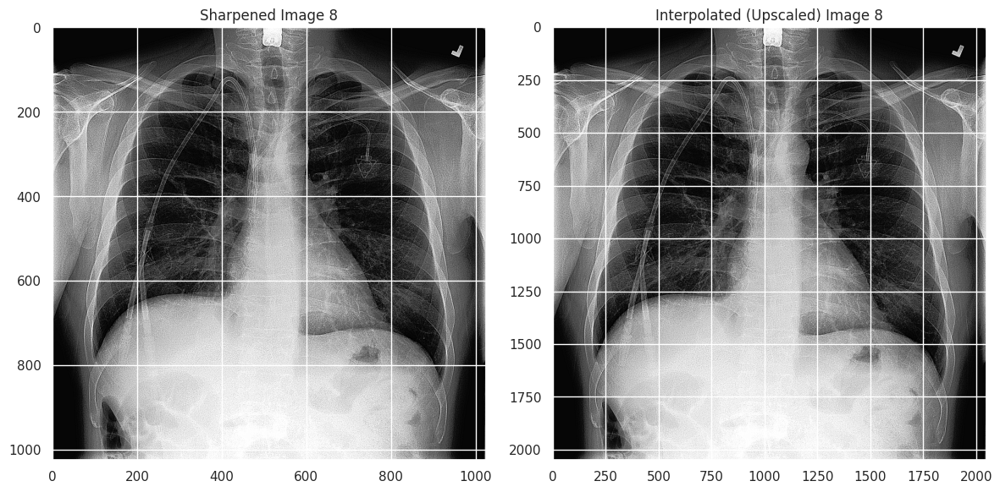

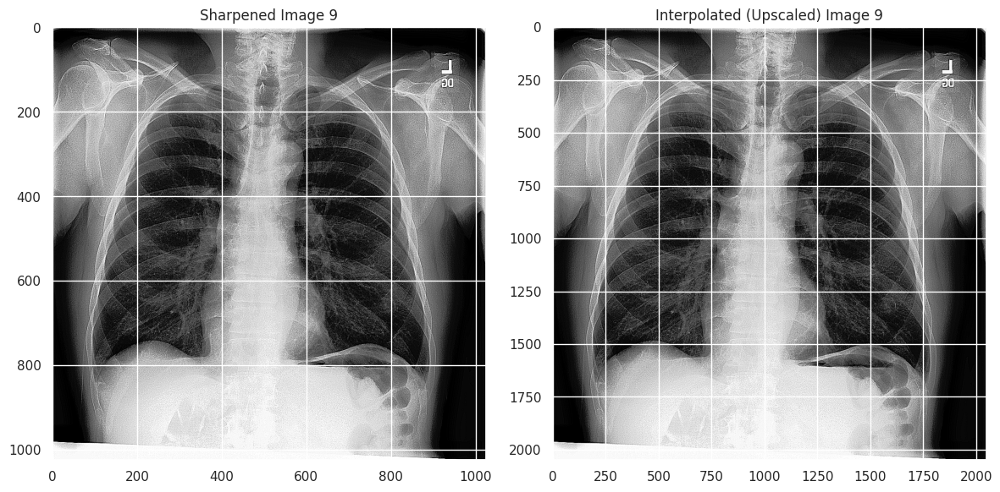

In [ ]:
for i in range(9):

  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1)
  plt.imshow(unsharp_masking_images[i], cmap='gray')
  plt.title(f"Sharpened Image {i+1}")

  plt.subplot(1, 2, 2)
  plt.imshow(bicubic_images[i], cmap='gray')
  plt.title(f"Interpolated (Upscaled) Image {i+1}")

  plt.tight_layout()
  plt.show()